<a href="https://colab.research.google.com/github/luoq03/Final-Project-Coding-Three-Exploring-to-Machine-Intelligence/blob/main/generate_cursive_font_dcgan_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')


/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

## Load the files

In [ ]:
BASE_DIR = '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/'

In [ ]:
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:50]

['/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/0664.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/1269.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/3863.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/2193.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/0733.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/3750.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/2008.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/2081.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/0106.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/0375.jpg',
 '/kaggle/input/chinese-calligraphy-styles-by-calligraphers/data/data/train/mf/3919.jpg',
 '/kaggle/

In [ ]:
len(image_paths)

5410

## Visualize the Image Dataset

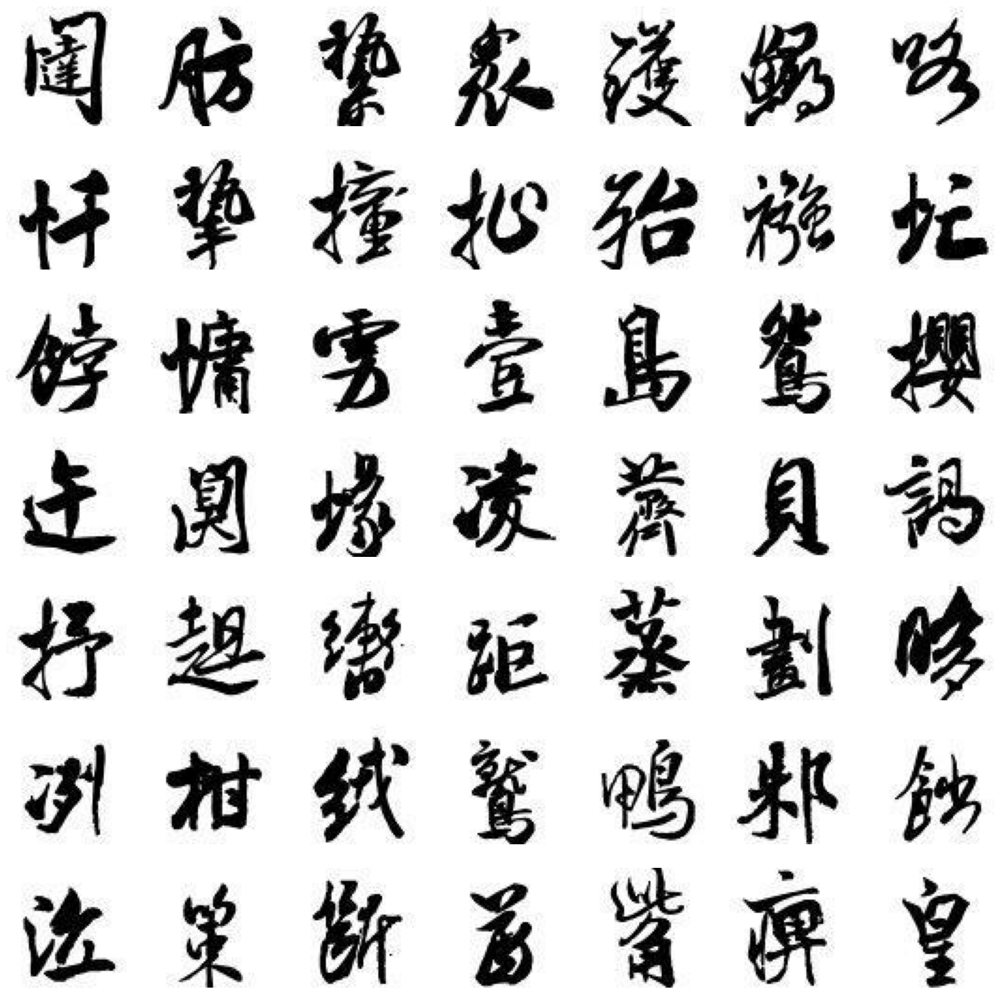

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [ ]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/5410 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.],
        ...,
        [1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.],
        ...,
        [1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.],
        ...,
        [1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       ...,

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.],
        ...,
        [1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.],
        ...,
        [1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.],
        ...,
        [1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]]], dtype=float32)

## Create Generator & Discriminator Models

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

## Generator Model

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 256)      2097408   
 nspose)                                                         
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

## Discriminator Model

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 64)       256       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

## Create DCGAN

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/70
170/170 [==============================] - ETA: 0s - d_loss: 1.3320 - g_loss: 1.7596

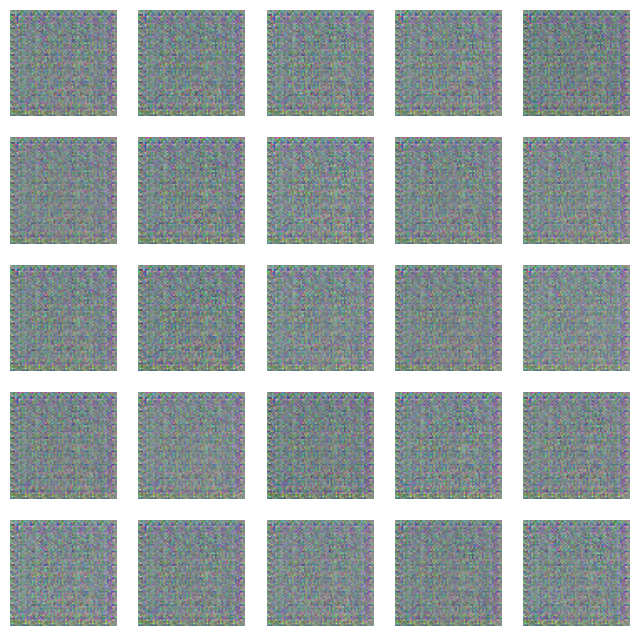

170/170 [==============================] - 396s 2s/step - d_loss: 1.3320 - g_loss: 1.7596
Epoch 2/70
170/170 [==============================] - ETA: 0s - d_loss: 0.0857 - g_loss: 3.6619

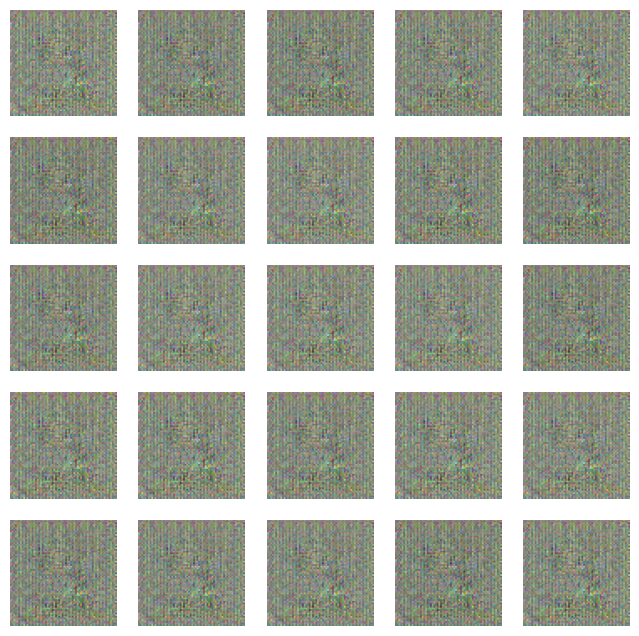

170/170 [==============================] - 390s 2s/step - d_loss: 0.0857 - g_loss: 3.6619
Epoch 3/70
170/170 [==============================] - ETA: 0s - d_loss: -0.0784 - g_loss: 4.1754

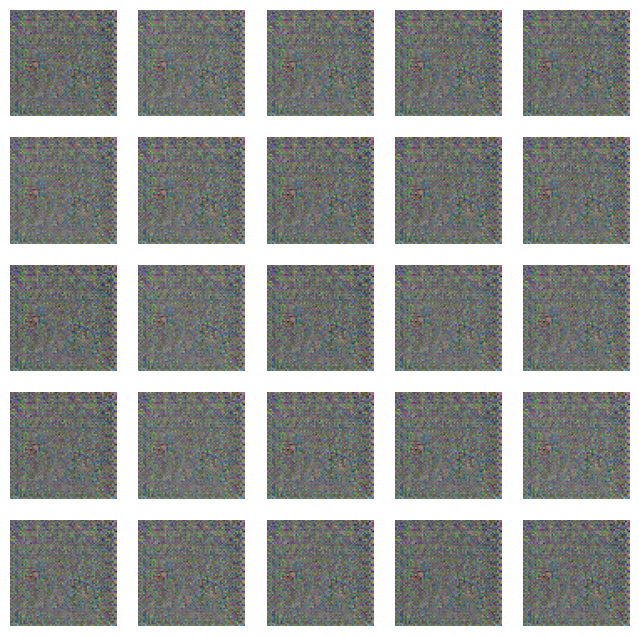

170/170 [==============================] - 385s 2s/step - d_loss: -0.0784 - g_loss: 4.1754
Epoch 4/70
170/170 [==============================] - ETA: 0s - d_loss: 0.1074 - g_loss: 4.2673

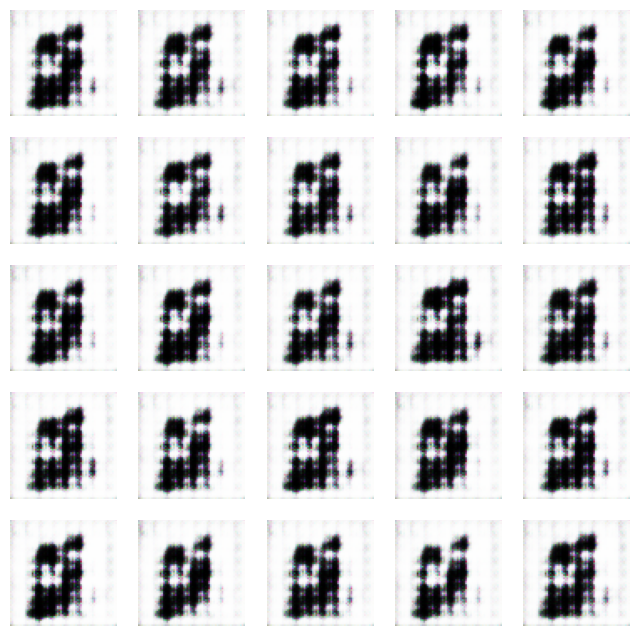

170/170 [==============================] - 391s 2s/step - d_loss: 0.1074 - g_loss: 4.2673
Epoch 5/70
170/170 [==============================] - ETA: 0s - d_loss: 0.1838 - g_loss: 2.9614

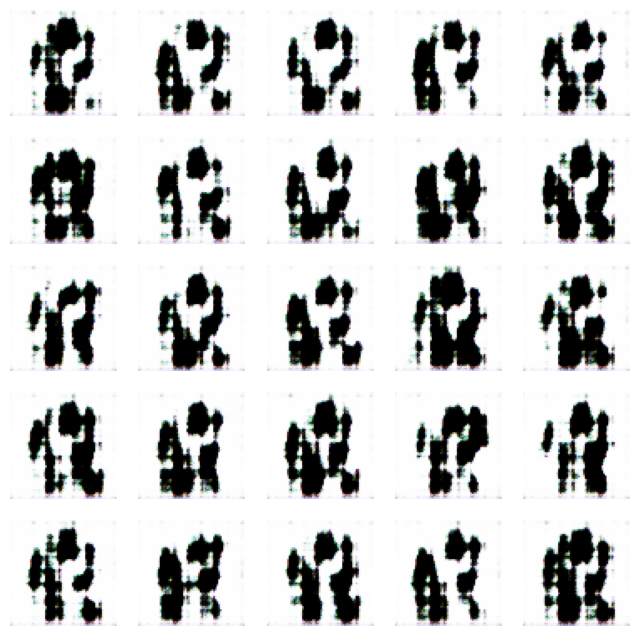

170/170 [==============================] - 385s 2s/step - d_loss: 0.1838 - g_loss: 2.9614
Epoch 6/70
170/170 [==============================] - ETA: 0s - d_loss: 0.2124 - g_loss: 2.9924

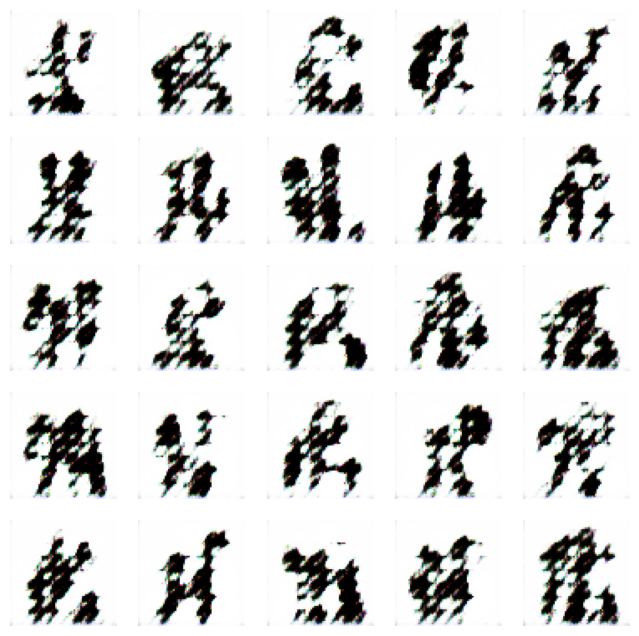

170/170 [==============================] - 384s 2s/step - d_loss: 0.2124 - g_loss: 2.9924
Epoch 7/70
170/170 [==============================] - ETA: 0s - d_loss: 0.2184 - g_loss: 2.5507

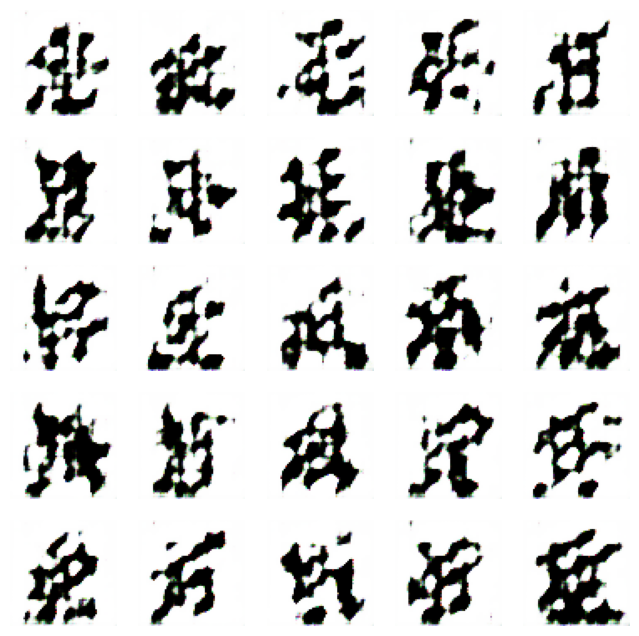

170/170 [==============================] - 387s 2s/step - d_loss: 0.2184 - g_loss: 2.5507
Epoch 8/70
170/170 [==============================] - ETA: 0s - d_loss: 0.2953 - g_loss: 2.4501

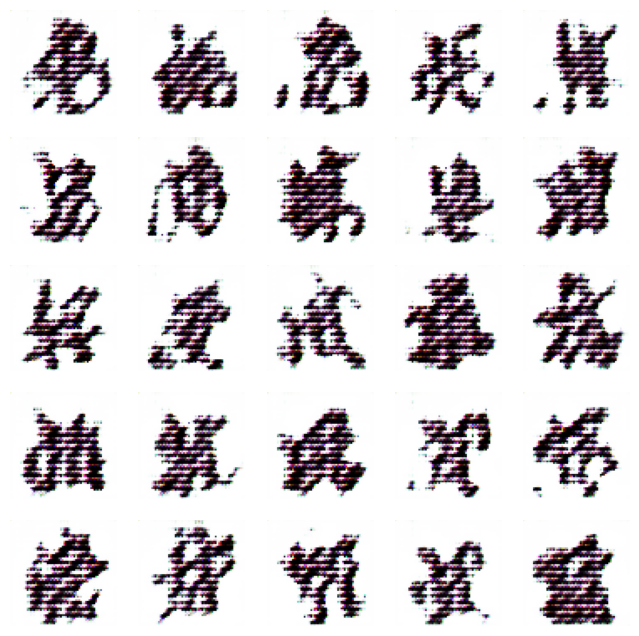

170/170 [==============================] - 387s 2s/step - d_loss: 0.2953 - g_loss: 2.4501
Epoch 9/70
170/170 [==============================] - ETA: 0s - d_loss: 0.3433 - g_loss: 2.4772

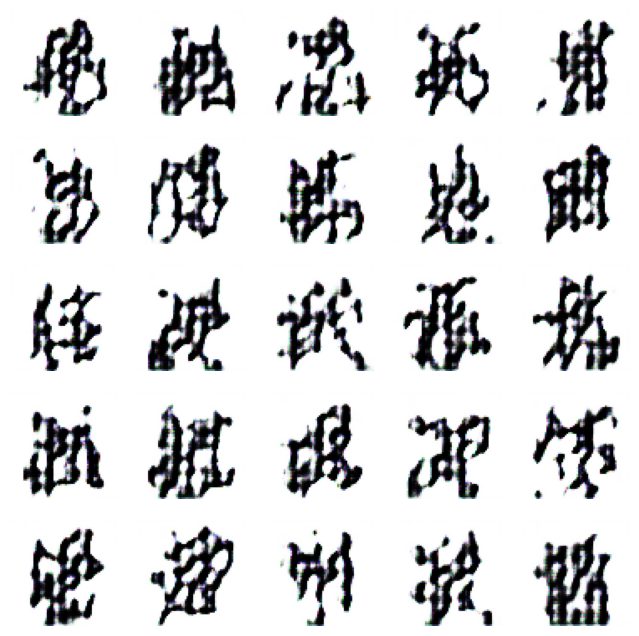

170/170 [==============================] - 383s 2s/step - d_loss: 0.3433 - g_loss: 2.4772
Epoch 10/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4465 - g_loss: 2.0312

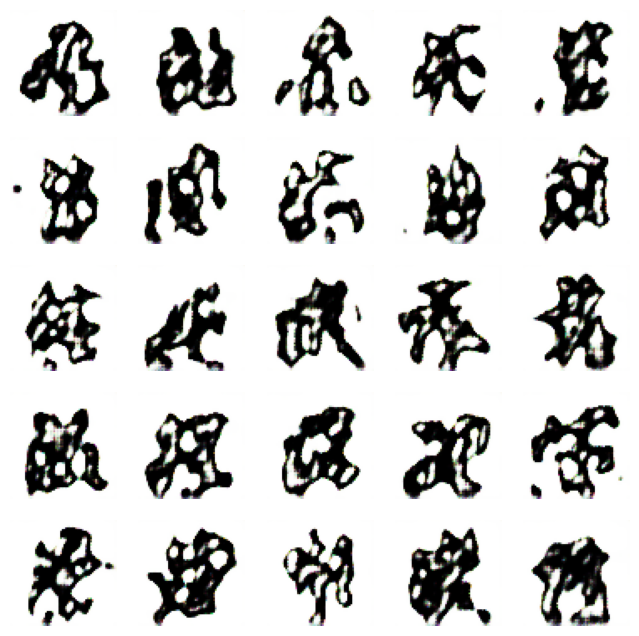

170/170 [==============================] - 385s 2s/step - d_loss: 0.4465 - g_loss: 2.0312
Epoch 11/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4924 - g_loss: 1.5247

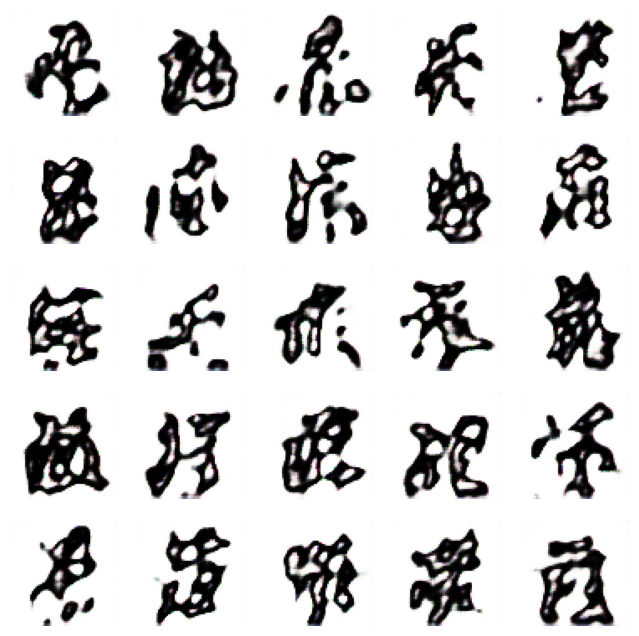

170/170 [==============================] - 411s 2s/step - d_loss: 0.4924 - g_loss: 1.5247
Epoch 12/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4471 - g_loss: 1.7516

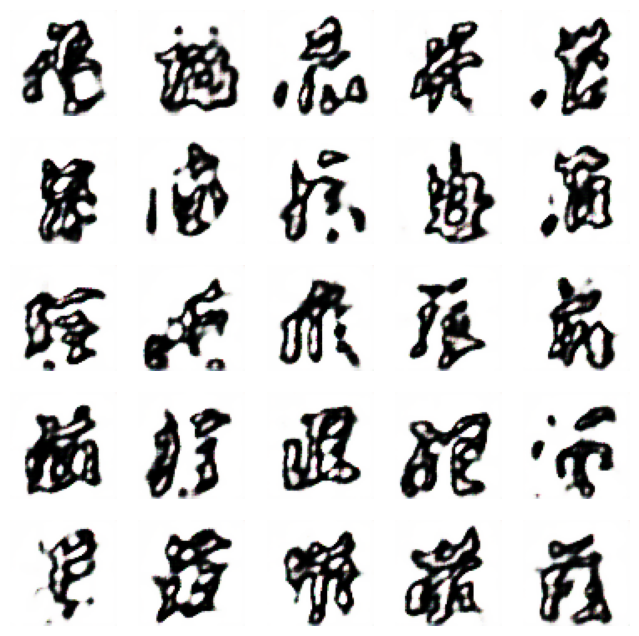

170/170 [==============================] - 384s 2s/step - d_loss: 0.4471 - g_loss: 1.7516
Epoch 13/70
170/170 [==============================] - ETA: 0s - d_loss: 0.3864 - g_loss: 1.9916

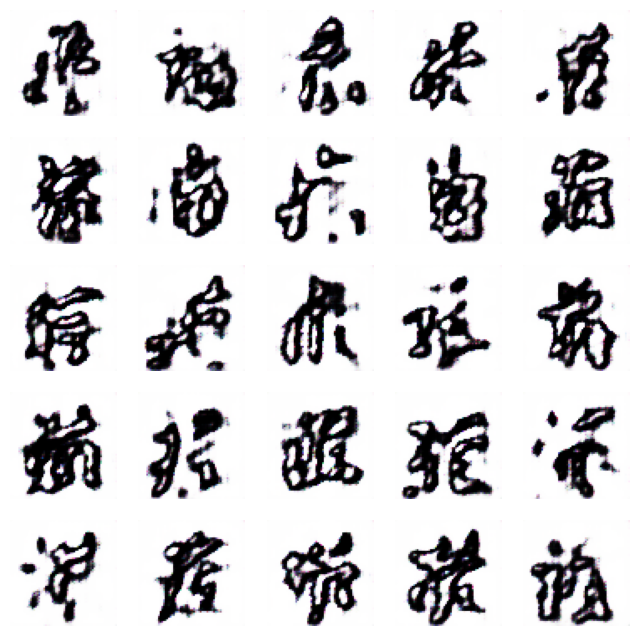

170/170 [==============================] - 382s 2s/step - d_loss: 0.3864 - g_loss: 1.9916
Epoch 14/70
170/170 [==============================] - ETA: 0s - d_loss: 0.3449 - g_loss: 2.4371

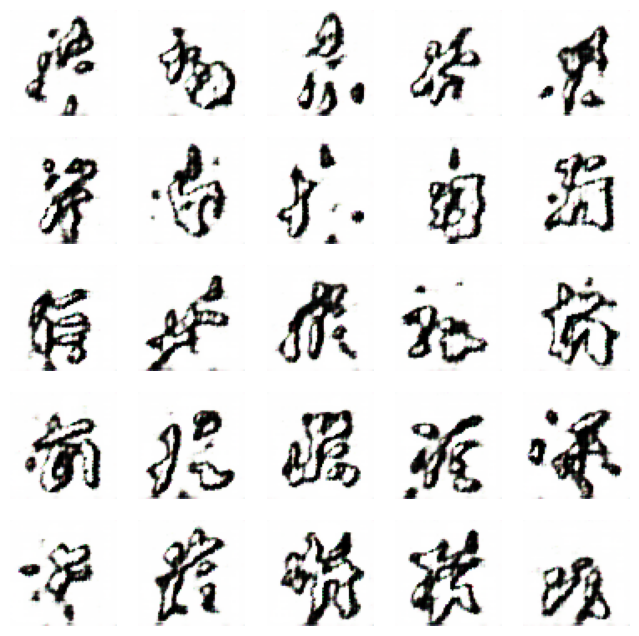

170/170 [==============================] - 385s 2s/step - d_loss: 0.3449 - g_loss: 2.4371
Epoch 15/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4185 - g_loss: 2.3070

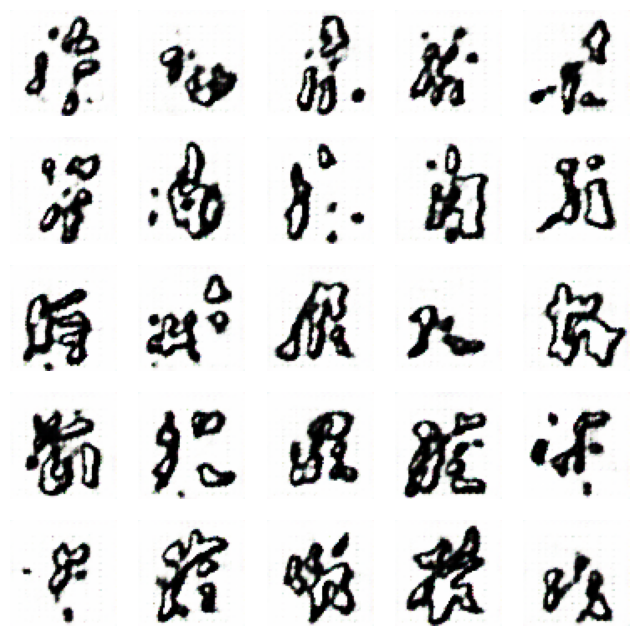

170/170 [==============================] - 385s 2s/step - d_loss: 0.4185 - g_loss: 2.3070
Epoch 16/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4788 - g_loss: 1.8797

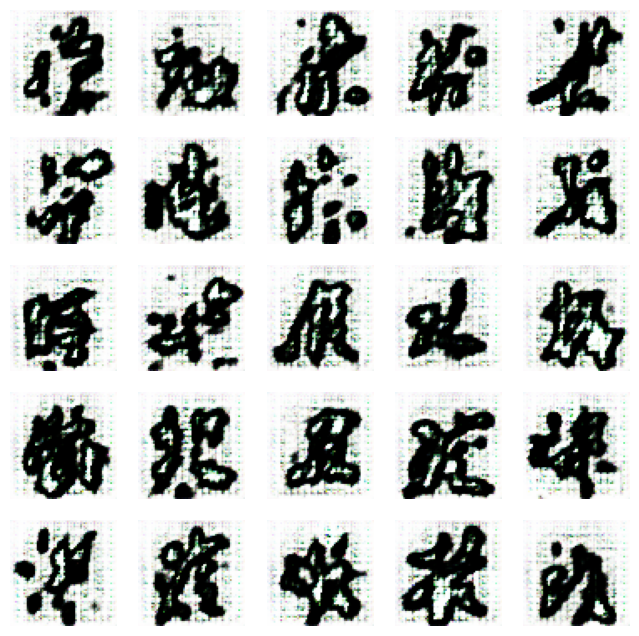

170/170 [==============================] - 386s 2s/step - d_loss: 0.4788 - g_loss: 1.8797
Epoch 17/70
170/170 [==============================] - ETA: 0s - d_loss: 0.3958 - g_loss: 2.2477

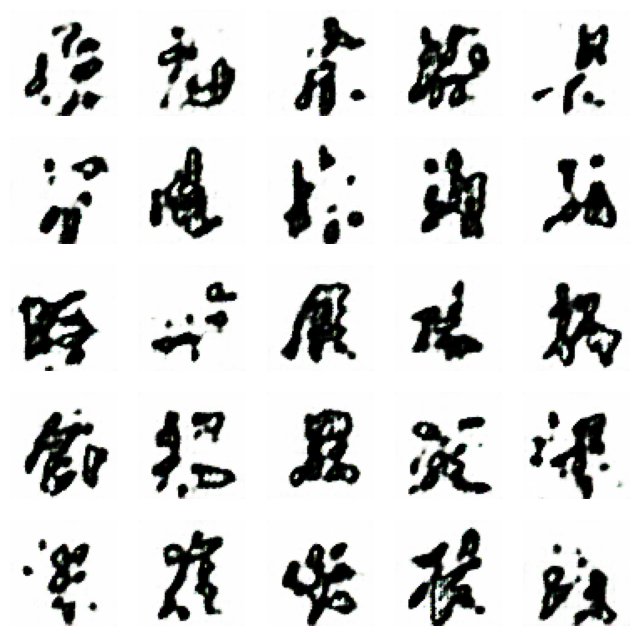

170/170 [==============================] - 388s 2s/step - d_loss: 0.3958 - g_loss: 2.2477
Epoch 18/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4160 - g_loss: 2.1149

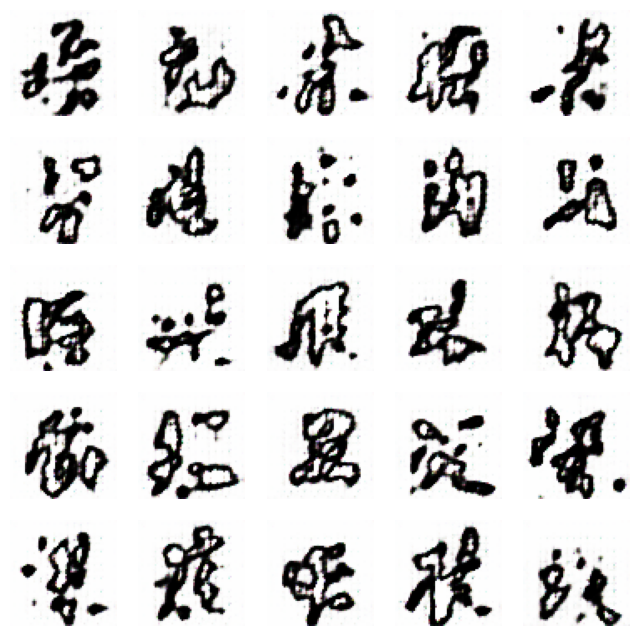

170/170 [==============================] - 402s 2s/step - d_loss: 0.4160 - g_loss: 2.1149
Epoch 19/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4574 - g_loss: 1.8867

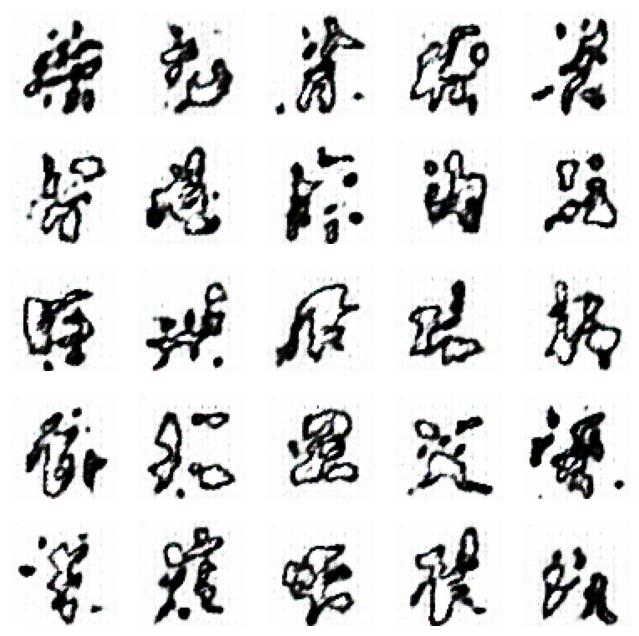

170/170 [==============================] - 431s 3s/step - d_loss: 0.4574 - g_loss: 1.8867
Epoch 20/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4150 - g_loss: 2.0065

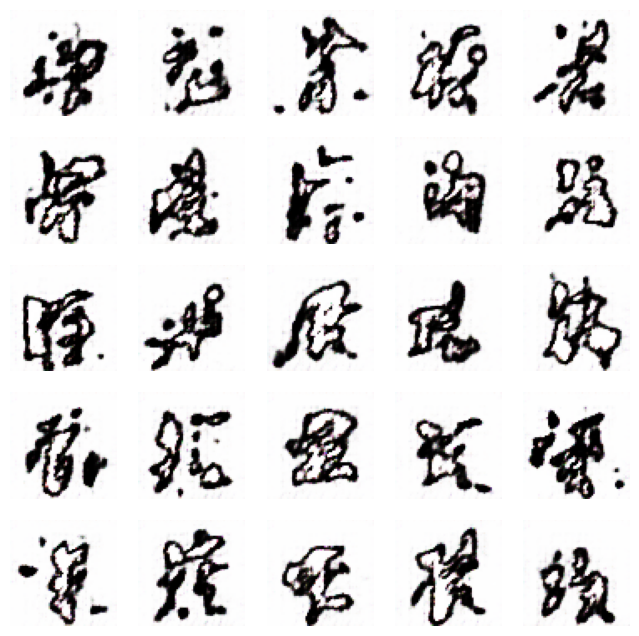

170/170 [==============================] - 430s 3s/step - d_loss: 0.4150 - g_loss: 2.0065
Epoch 21/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4312 - g_loss: 2.0082

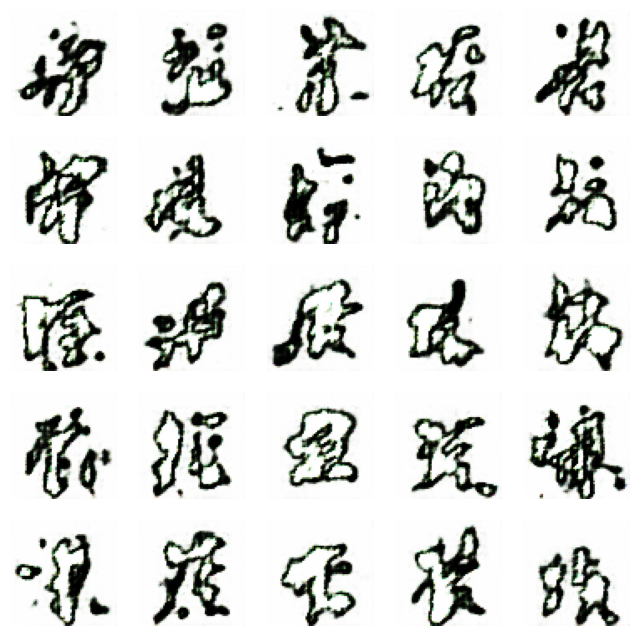

170/170 [==============================] - 433s 3s/step - d_loss: 0.4312 - g_loss: 2.0082
Epoch 22/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4848 - g_loss: 1.7532

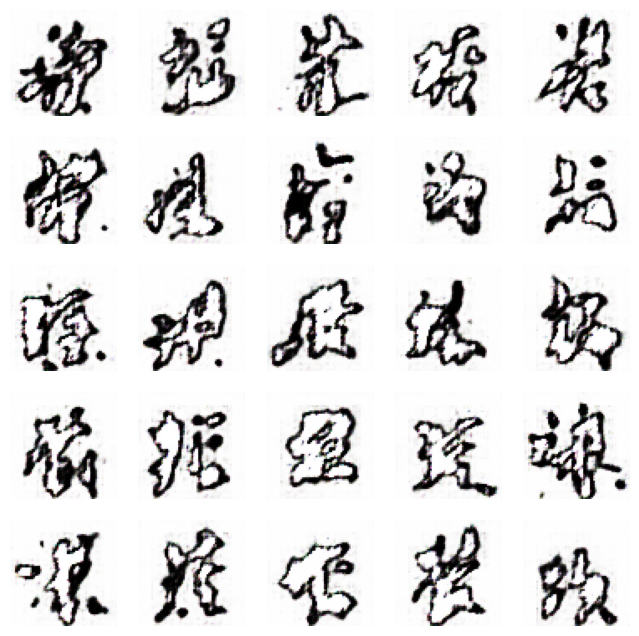

170/170 [==============================] - 435s 3s/step - d_loss: 0.4848 - g_loss: 1.7532
Epoch 23/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4160 - g_loss: 1.9098

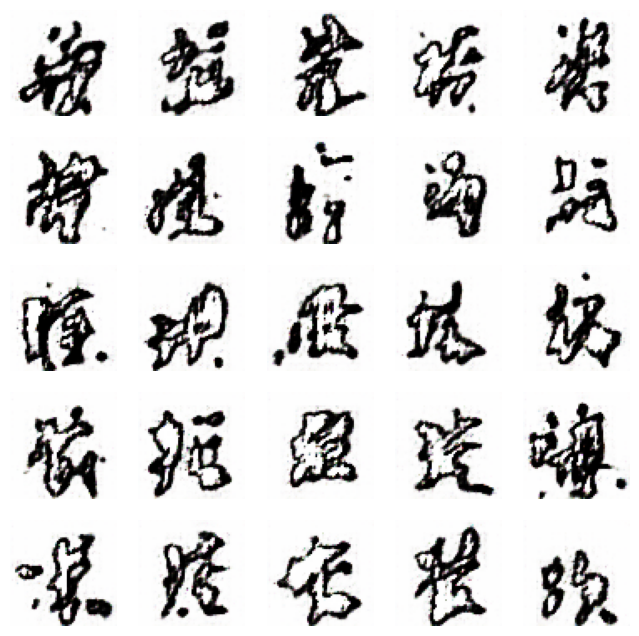

170/170 [==============================] - 434s 3s/step - d_loss: 0.4160 - g_loss: 1.9098
Epoch 24/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4403 - g_loss: 1.9575

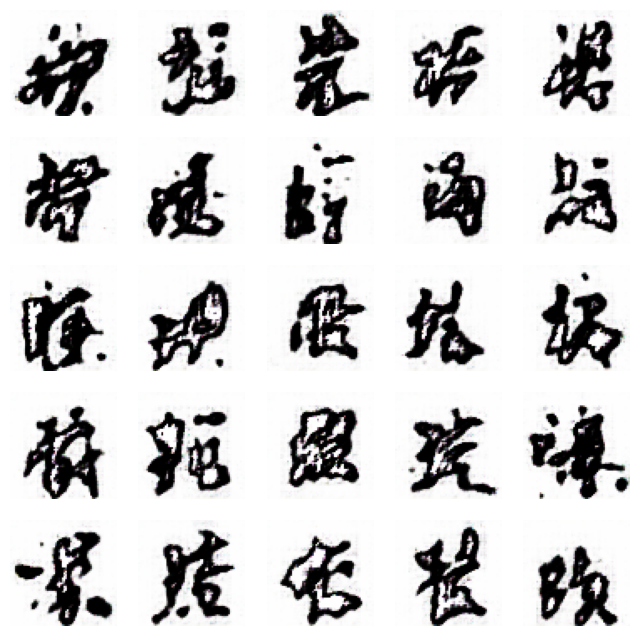

170/170 [==============================] - 435s 3s/step - d_loss: 0.4403 - g_loss: 1.9575
Epoch 25/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4440 - g_loss: 1.9207

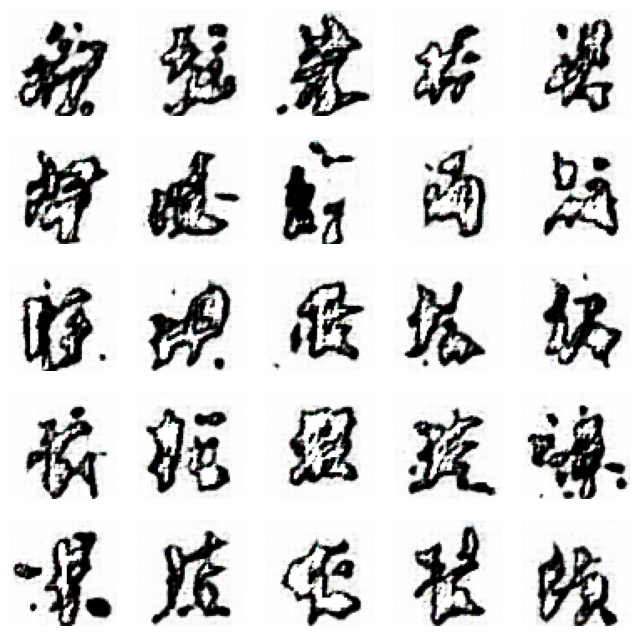

170/170 [==============================] - 417s 2s/step - d_loss: 0.4440 - g_loss: 1.9207
Epoch 26/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4667 - g_loss: 1.8303

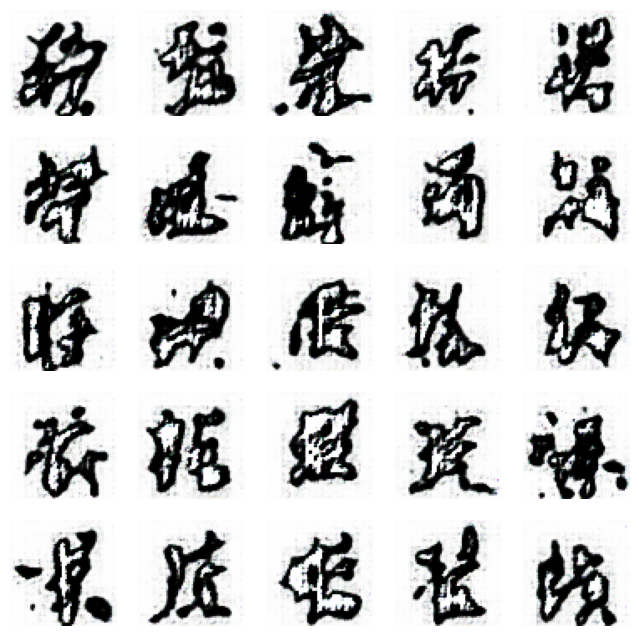

170/170 [==============================] - 383s 2s/step - d_loss: 0.4667 - g_loss: 1.8303
Epoch 27/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4399 - g_loss: 1.8261

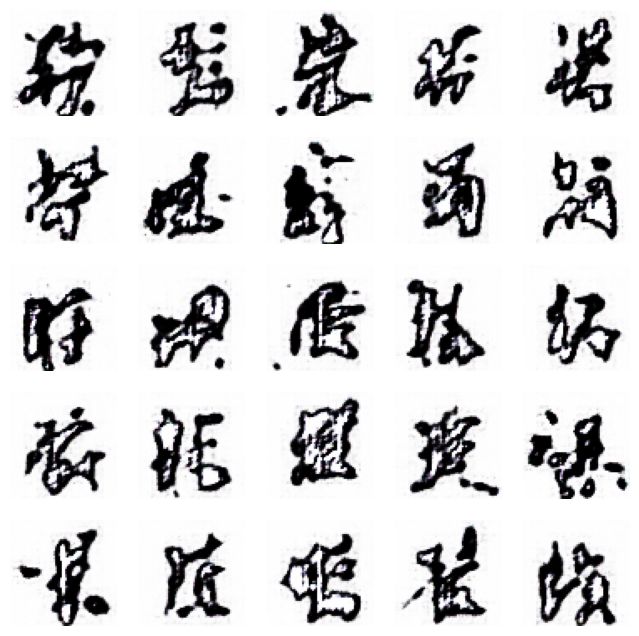

170/170 [==============================] - 383s 2s/step - d_loss: 0.4399 - g_loss: 1.8261
Epoch 28/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4683 - g_loss: 1.7833

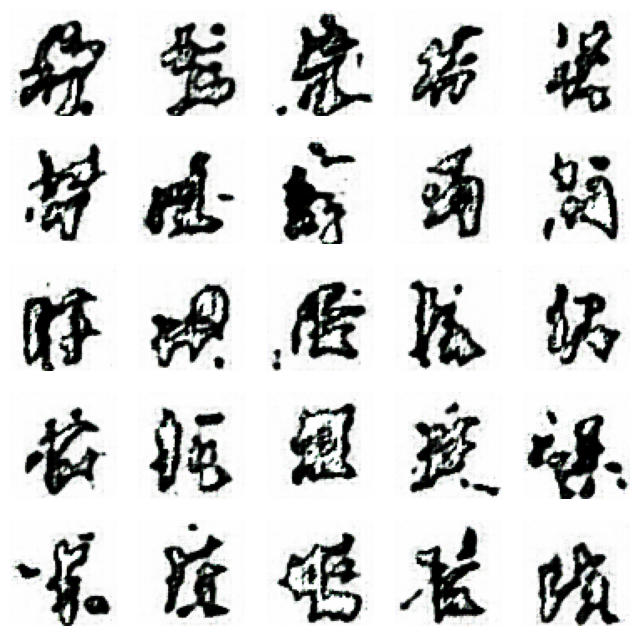

170/170 [==============================] - 383s 2s/step - d_loss: 0.4683 - g_loss: 1.7833
Epoch 29/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4220 - g_loss: 1.6964

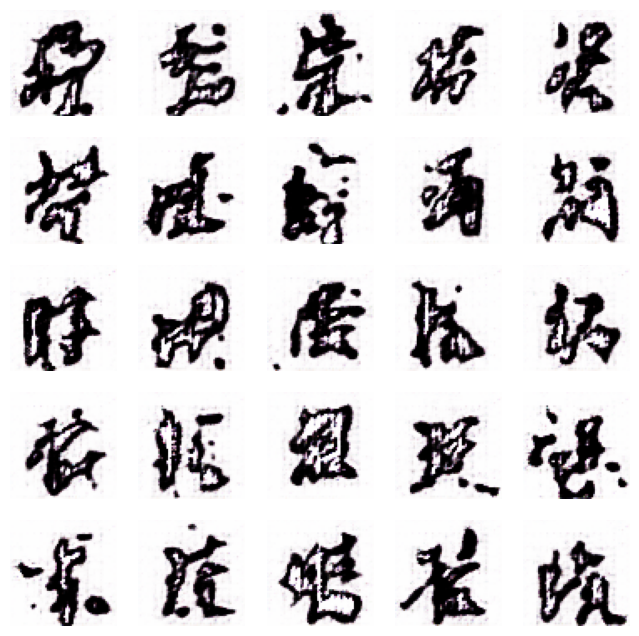

170/170 [==============================] - 384s 2s/step - d_loss: 0.4220 - g_loss: 1.6964
Epoch 30/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4135 - g_loss: 1.8536

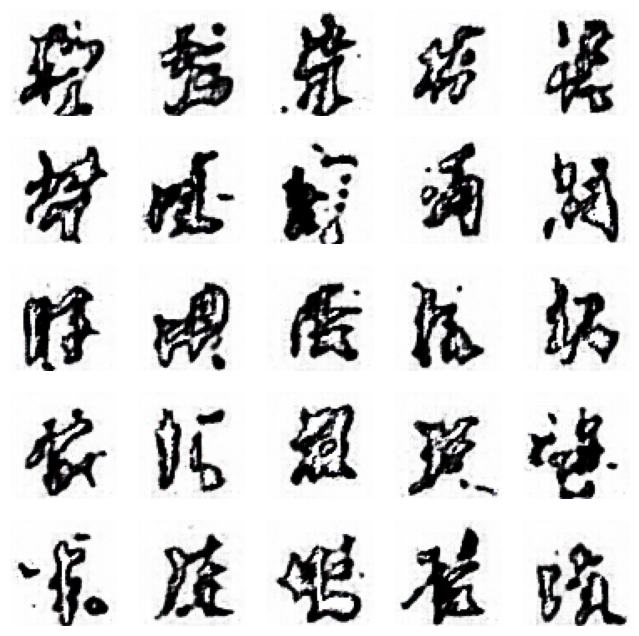

170/170 [==============================] - 388s 2s/step - d_loss: 0.4135 - g_loss: 1.8536
Epoch 31/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4234 - g_loss: 1.8697

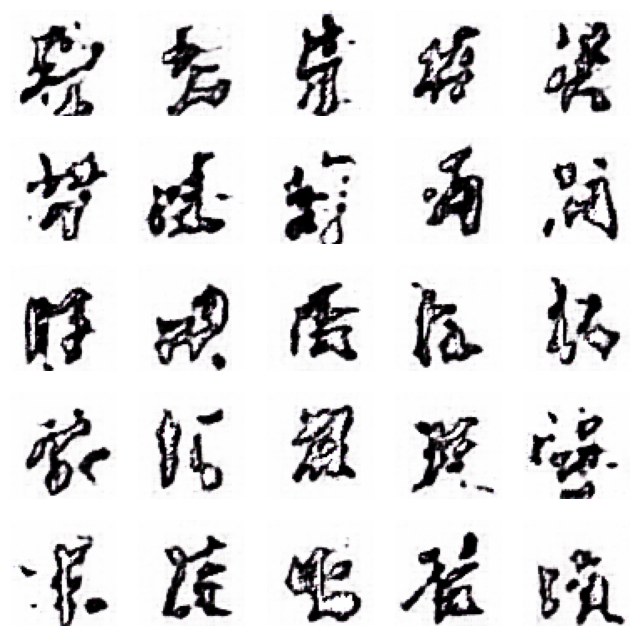

170/170 [==============================] - 385s 2s/step - d_loss: 0.4234 - g_loss: 1.8697
Epoch 32/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4308 - g_loss: 2.0554

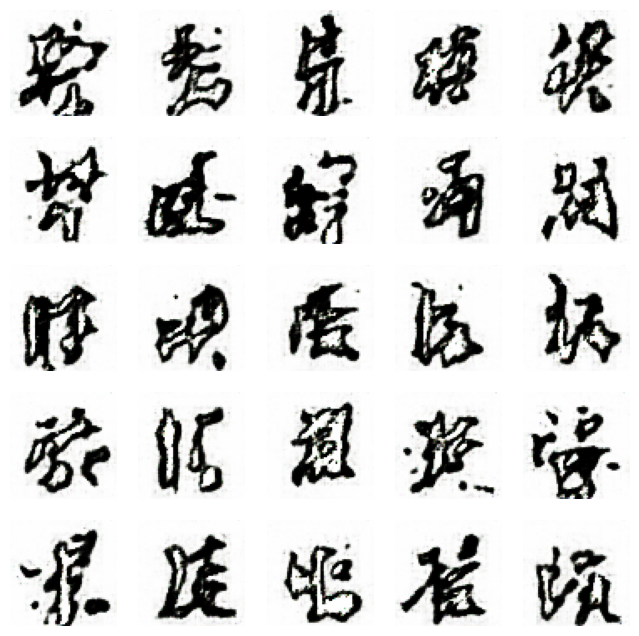

170/170 [==============================] - 385s 2s/step - d_loss: 0.4308 - g_loss: 2.0554
Epoch 33/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4344 - g_loss: 1.7561

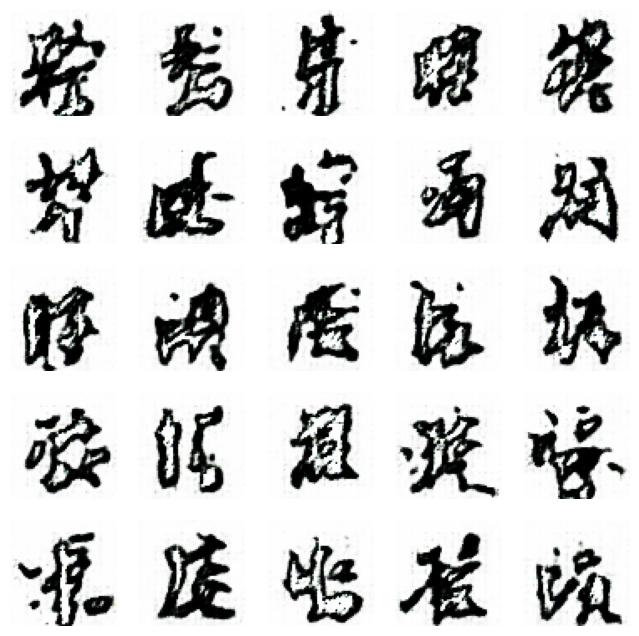

170/170 [==============================] - 385s 2s/step - d_loss: 0.4344 - g_loss: 1.7561
Epoch 34/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4728 - g_loss: 1.8127

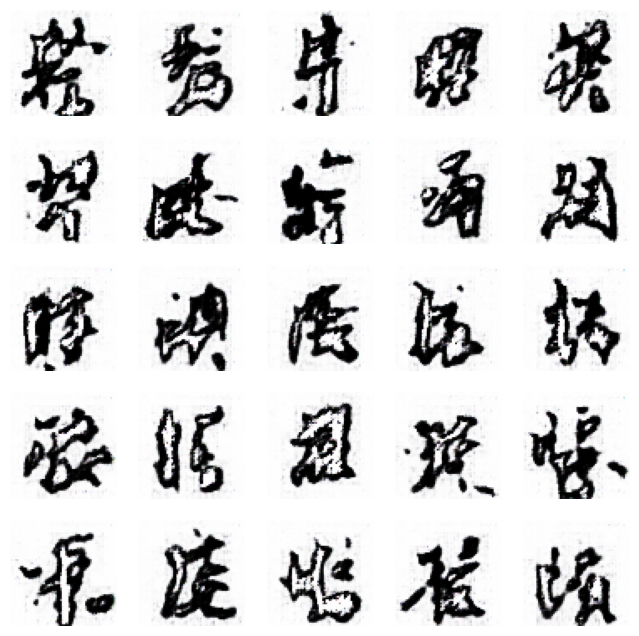

170/170 [==============================] - 384s 2s/step - d_loss: 0.4728 - g_loss: 1.8127
Epoch 35/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4689 - g_loss: 1.6053

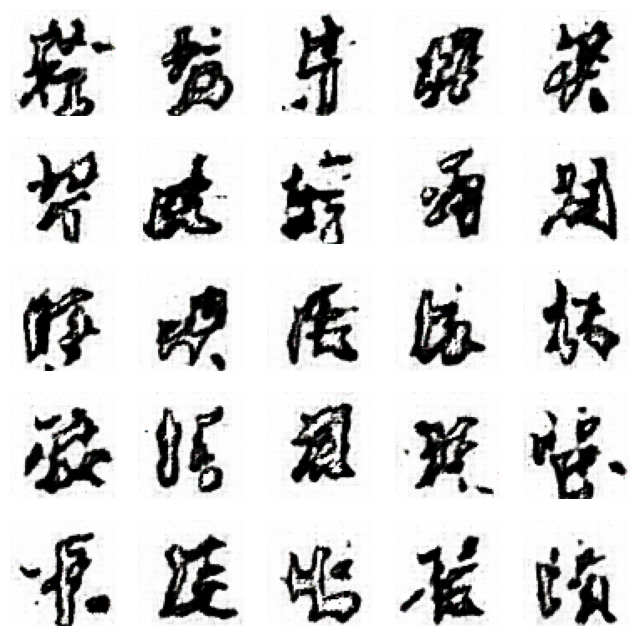

170/170 [==============================] - 385s 2s/step - d_loss: 0.4689 - g_loss: 1.6053
Epoch 36/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4416 - g_loss: 1.8571

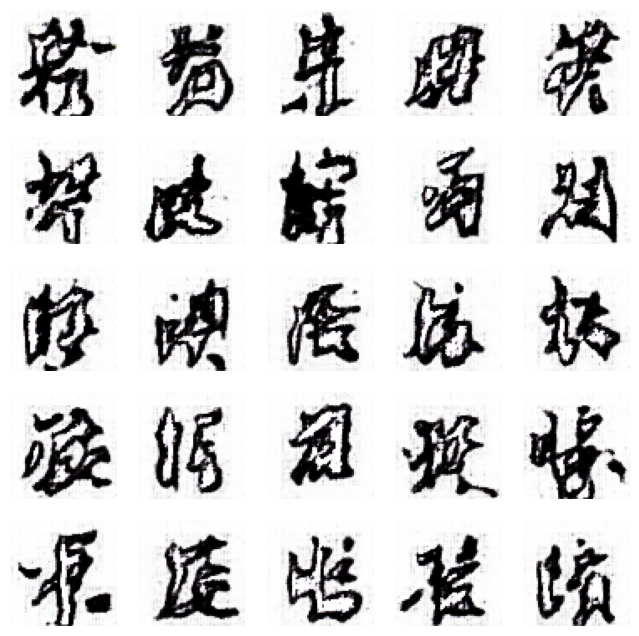

170/170 [==============================] - 384s 2s/step - d_loss: 0.4416 - g_loss: 1.8571
Epoch 37/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4615 - g_loss: 1.7310

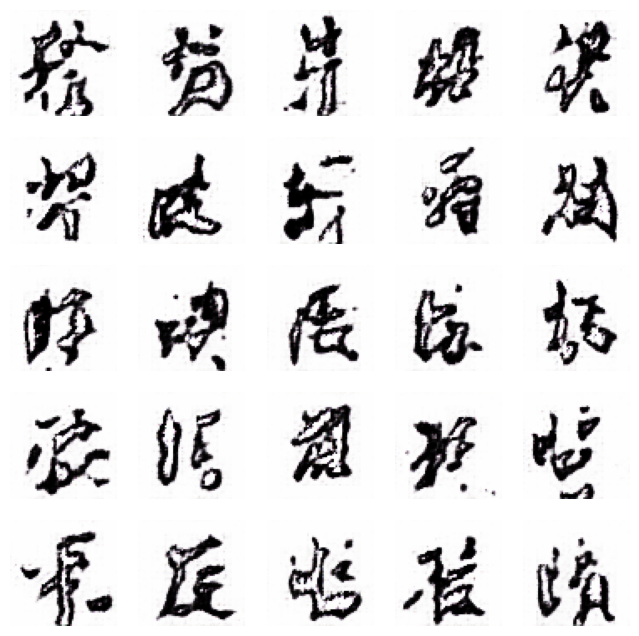

170/170 [==============================] - 383s 2s/step - d_loss: 0.4615 - g_loss: 1.7310
Epoch 38/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4340 - g_loss: 1.7584

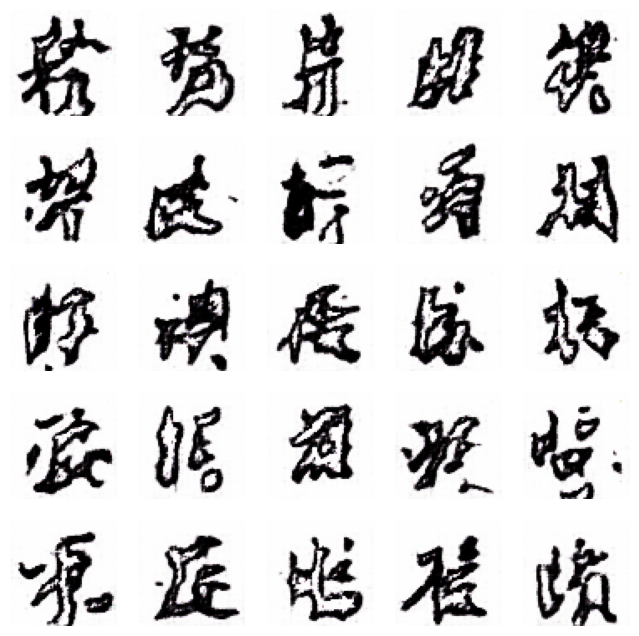

170/170 [==============================] - 383s 2s/step - d_loss: 0.4340 - g_loss: 1.7584
Epoch 39/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4665 - g_loss: 1.6434

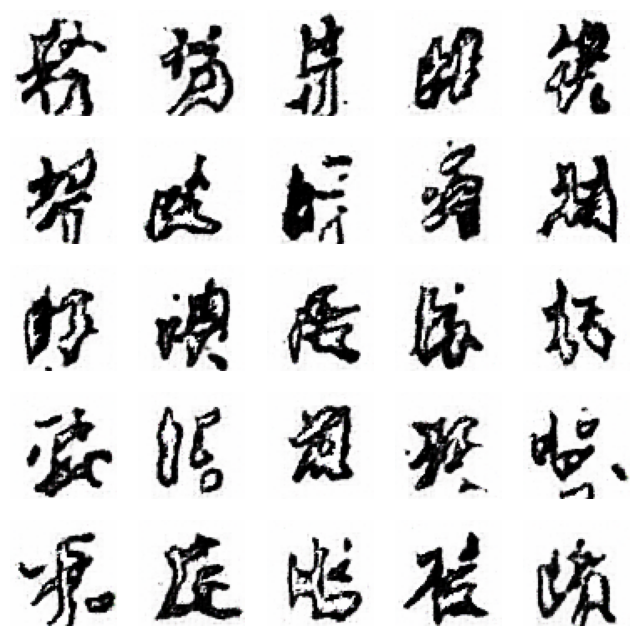

170/170 [==============================] - 383s 2s/step - d_loss: 0.4665 - g_loss: 1.6434
Epoch 40/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4850 - g_loss: 1.7126

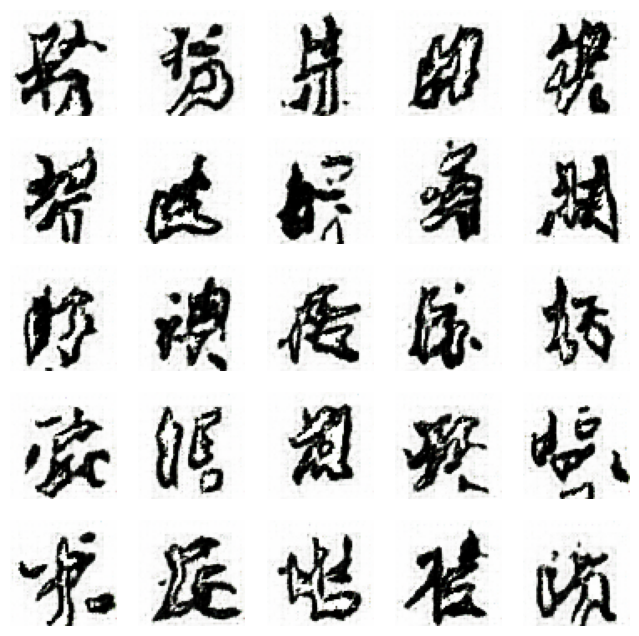

170/170 [==============================] - 385s 2s/step - d_loss: 0.4850 - g_loss: 1.7126
Epoch 41/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4734 - g_loss: 1.6324

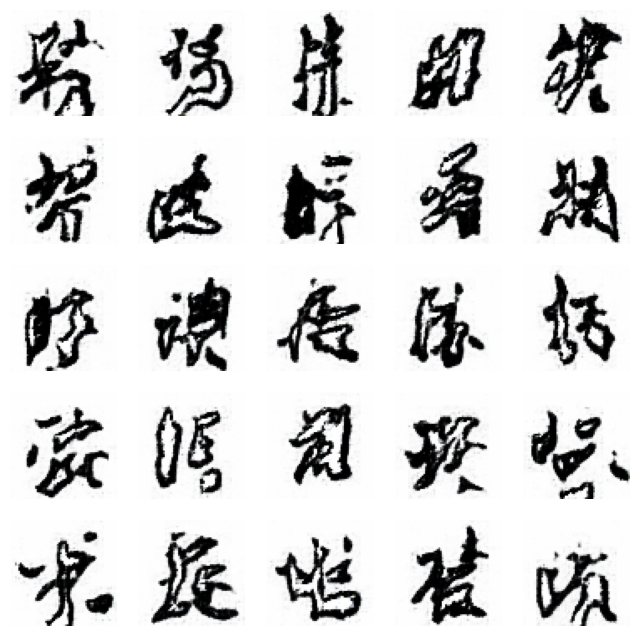

170/170 [==============================] - 402s 2s/step - d_loss: 0.4734 - g_loss: 1.6324
Epoch 42/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4642 - g_loss: 1.6564

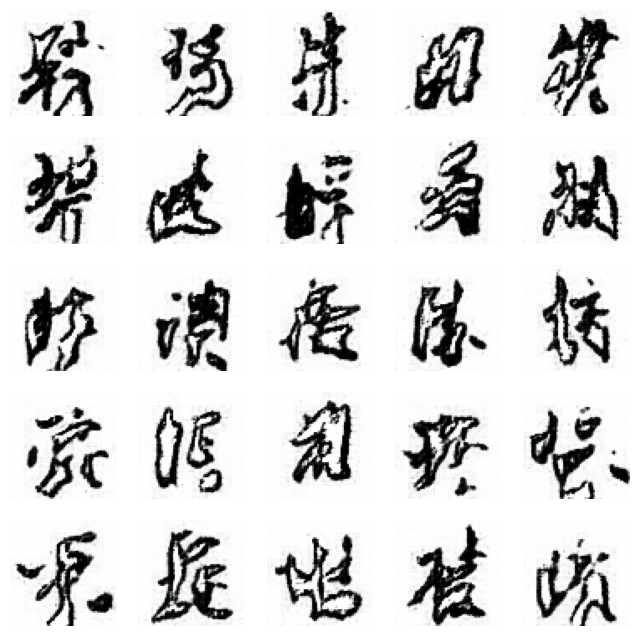

170/170 [==============================] - 415s 2s/step - d_loss: 0.4642 - g_loss: 1.6564
Epoch 43/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4724 - g_loss: 1.7044

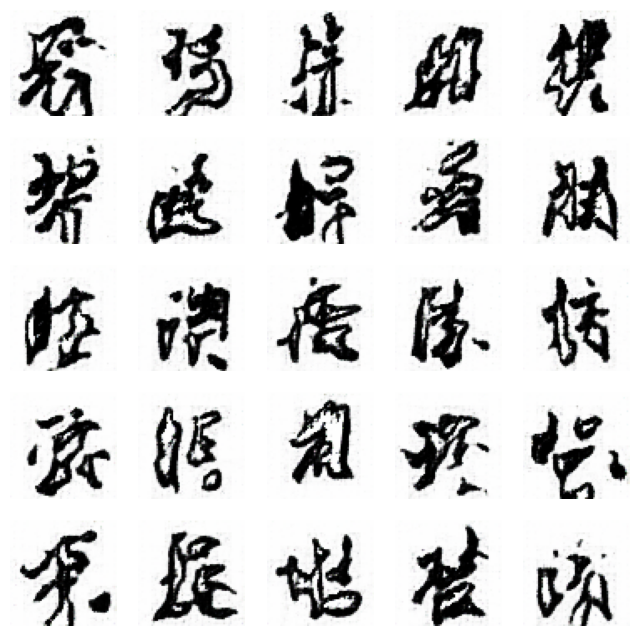

170/170 [==============================] - 404s 2s/step - d_loss: 0.4724 - g_loss: 1.7044
Epoch 44/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4930 - g_loss: 1.6441

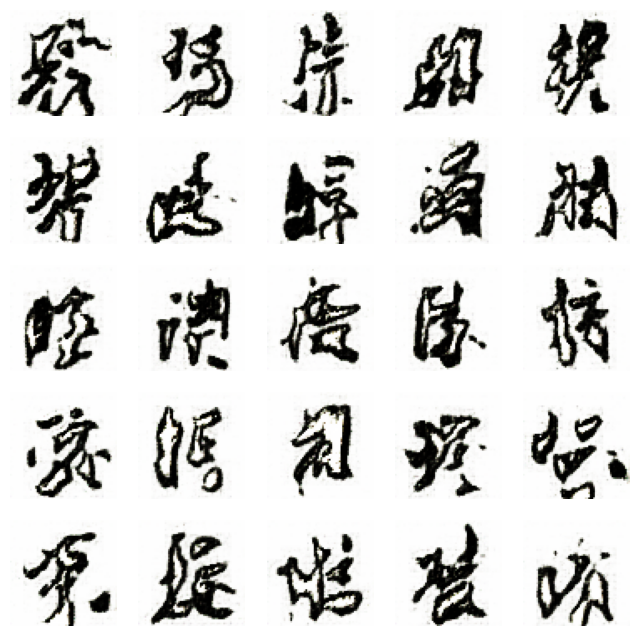

170/170 [==============================] - 398s 2s/step - d_loss: 0.4930 - g_loss: 1.6441
Epoch 45/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5033 - g_loss: 1.5463

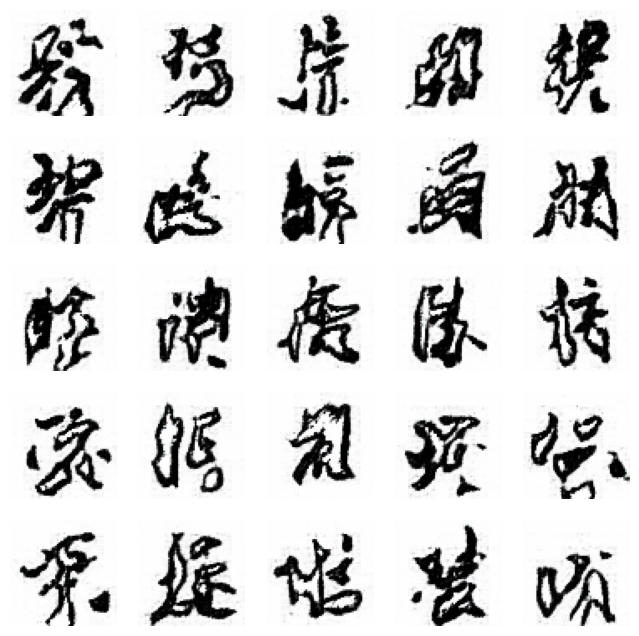

170/170 [==============================] - 384s 2s/step - d_loss: 0.5033 - g_loss: 1.5463
Epoch 46/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4668 - g_loss: 1.6026

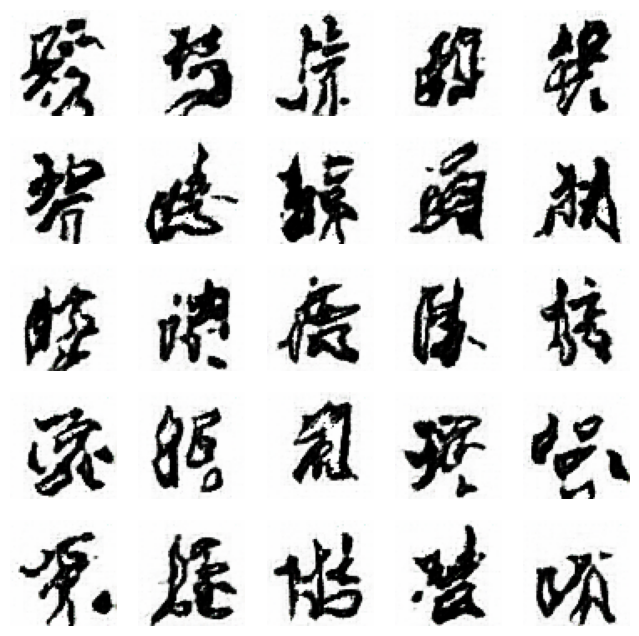

170/170 [==============================] - 395s 2s/step - d_loss: 0.4668 - g_loss: 1.6026
Epoch 47/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4690 - g_loss: 1.5951

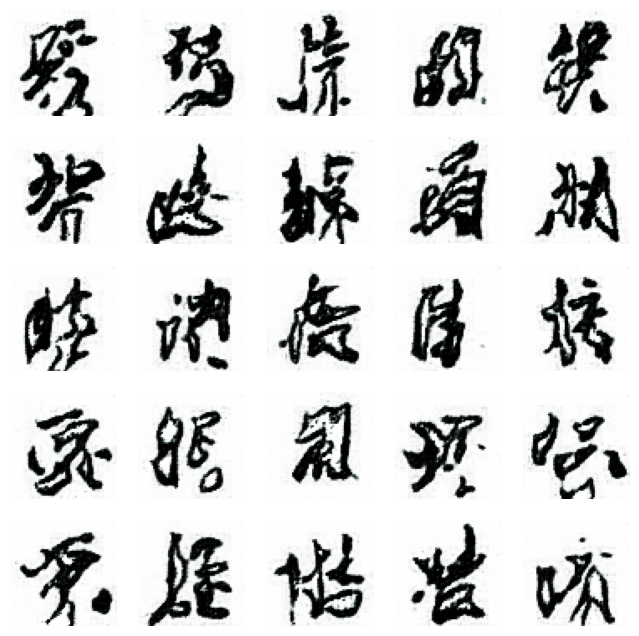

170/170 [==============================] - 384s 2s/step - d_loss: 0.4690 - g_loss: 1.5951
Epoch 48/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5315 - g_loss: 1.5854

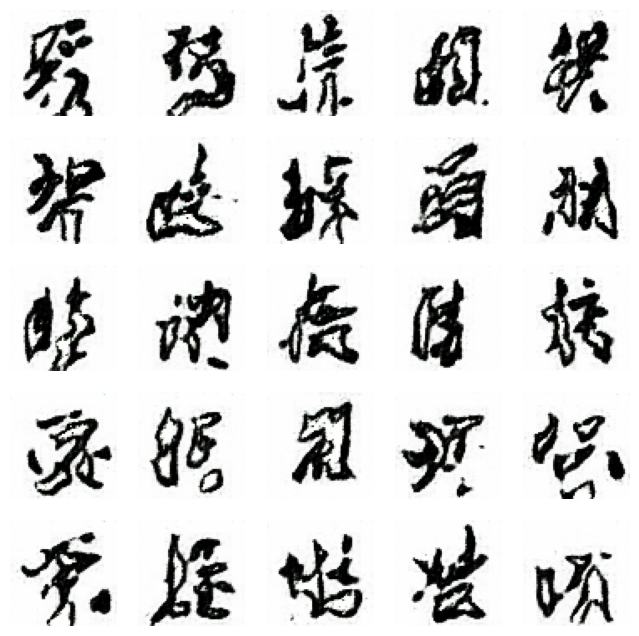

170/170 [==============================] - 385s 2s/step - d_loss: 0.5315 - g_loss: 1.5854
Epoch 49/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4974 - g_loss: 1.4837

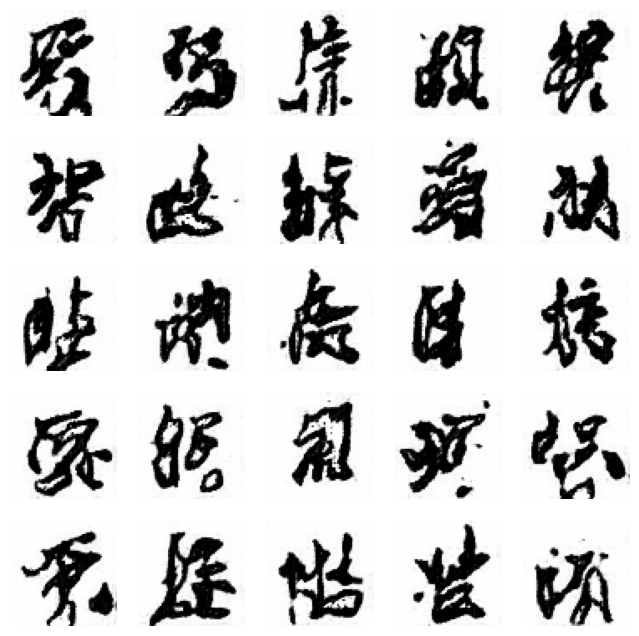

170/170 [==============================] - 387s 2s/step - d_loss: 0.4974 - g_loss: 1.4837
Epoch 50/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5136 - g_loss: 1.5160

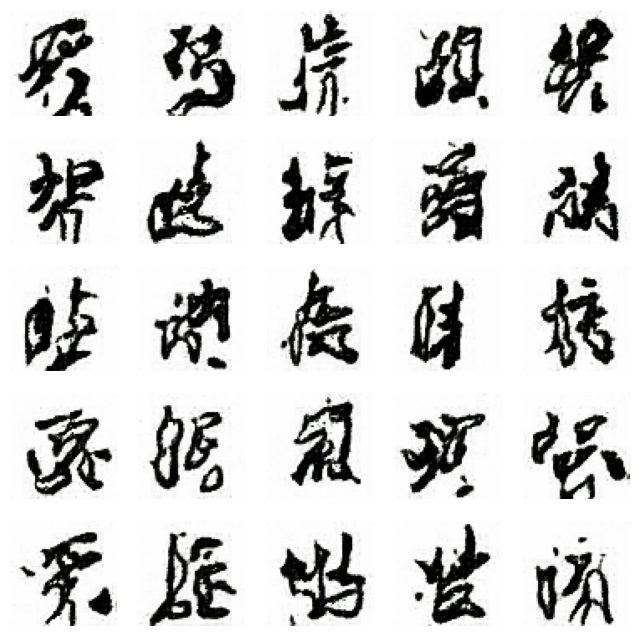

170/170 [==============================] - 383s 2s/step - d_loss: 0.5136 - g_loss: 1.5160
Epoch 51/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4798 - g_loss: 1.5841

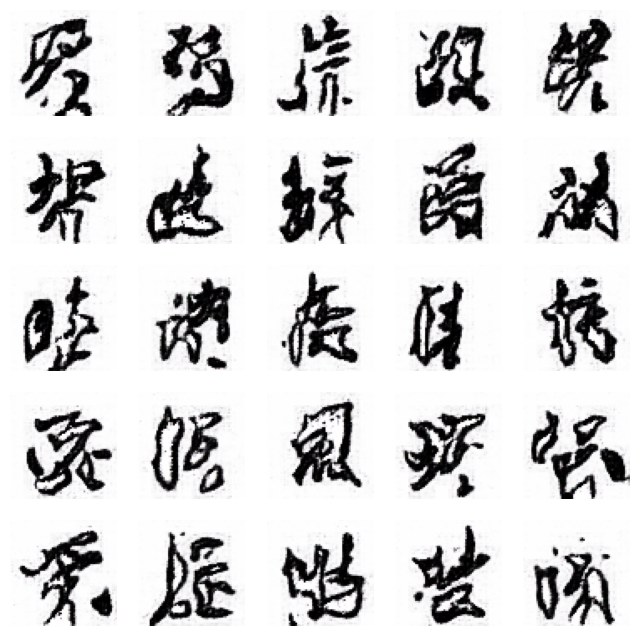

170/170 [==============================] - 382s 2s/step - d_loss: 0.4798 - g_loss: 1.5841
Epoch 52/70
170/170 [==============================] - ETA: 0s - d_loss: 0.4671 - g_loss: 1.6299

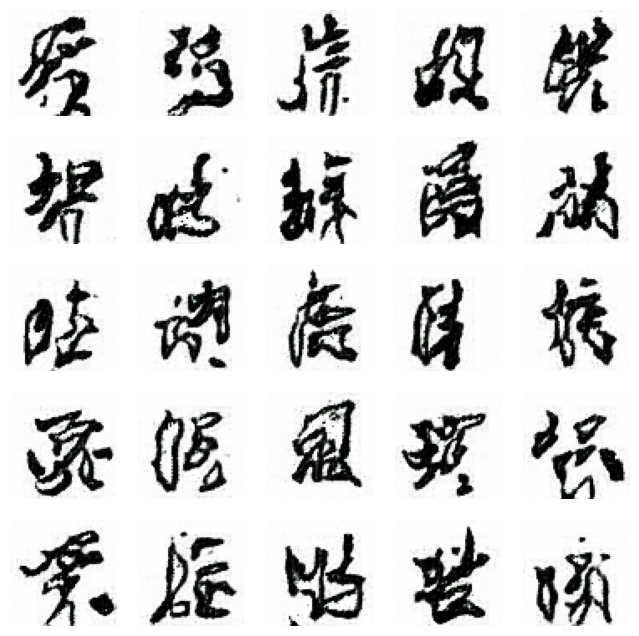

170/170 [==============================] - 382s 2s/step - d_loss: 0.4671 - g_loss: 1.6299
Epoch 53/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5162 - g_loss: 1.5420

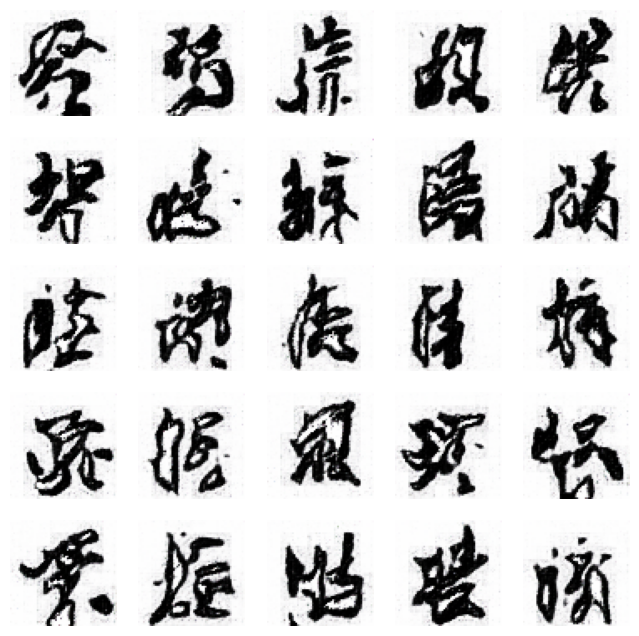

170/170 [==============================] - 383s 2s/step - d_loss: 0.5162 - g_loss: 1.5420
Epoch 54/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5220 - g_loss: 1.4570

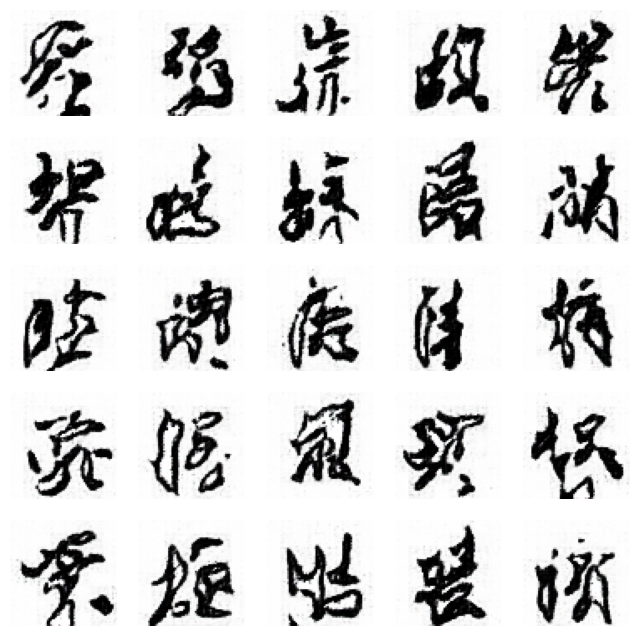

170/170 [==============================] - 383s 2s/step - d_loss: 0.5220 - g_loss: 1.4570
Epoch 55/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5260 - g_loss: 1.4624

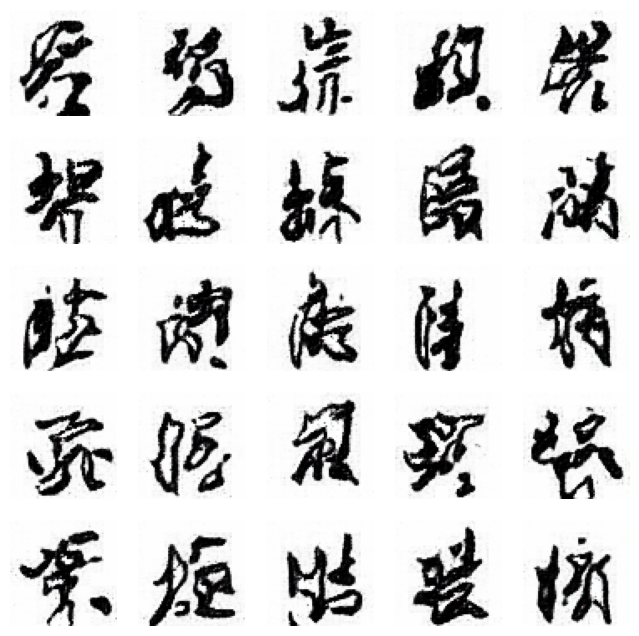

170/170 [==============================] - 382s 2s/step - d_loss: 0.5260 - g_loss: 1.4624
Epoch 56/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5250 - g_loss: 1.4613

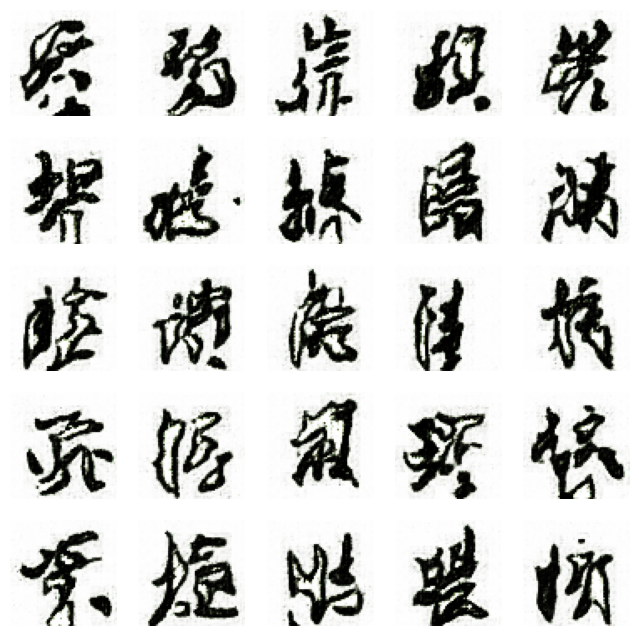

170/170 [==============================] - 382s 2s/step - d_loss: 0.5250 - g_loss: 1.4613
Epoch 57/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5003 - g_loss: 1.4378

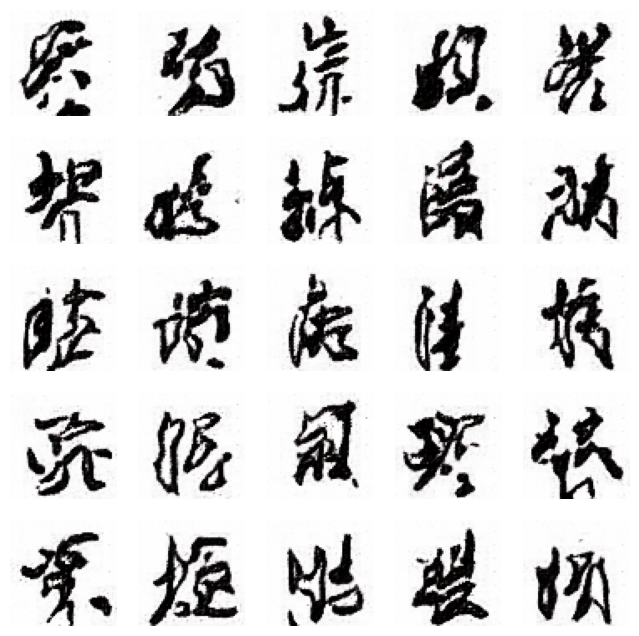

170/170 [==============================] - 382s 2s/step - d_loss: 0.5003 - g_loss: 1.4378
Epoch 58/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5359 - g_loss: 1.4707

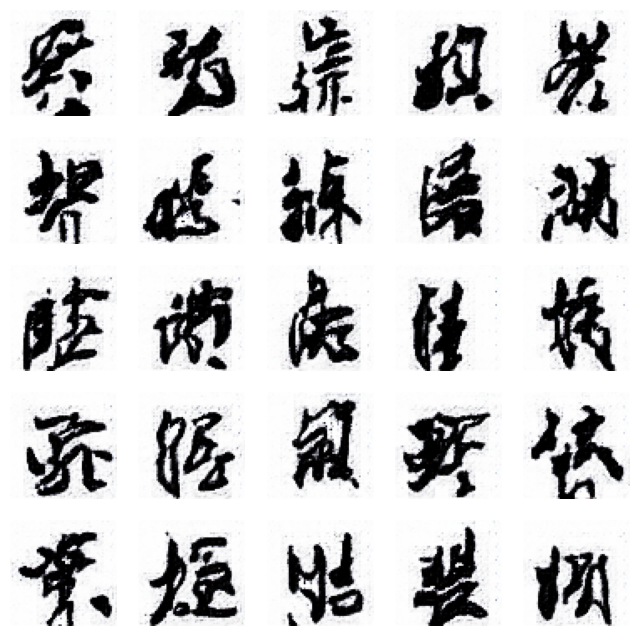

170/170 [==============================] - 383s 2s/step - d_loss: 0.5359 - g_loss: 1.4707
Epoch 59/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5175 - g_loss: 1.4698

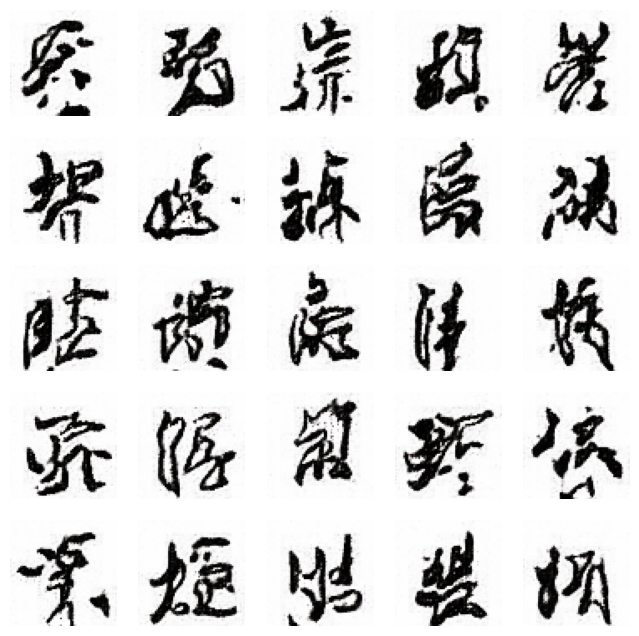

170/170 [==============================] - 383s 2s/step - d_loss: 0.5175 - g_loss: 1.4698
Epoch 60/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5083 - g_loss: 1.4524

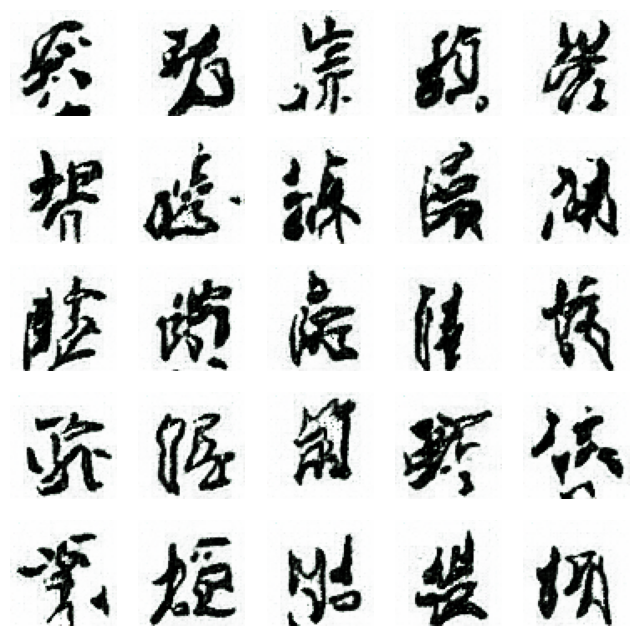

170/170 [==============================] - 386s 2s/step - d_loss: 0.5083 - g_loss: 1.4524
Epoch 61/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5232 - g_loss: 1.4277

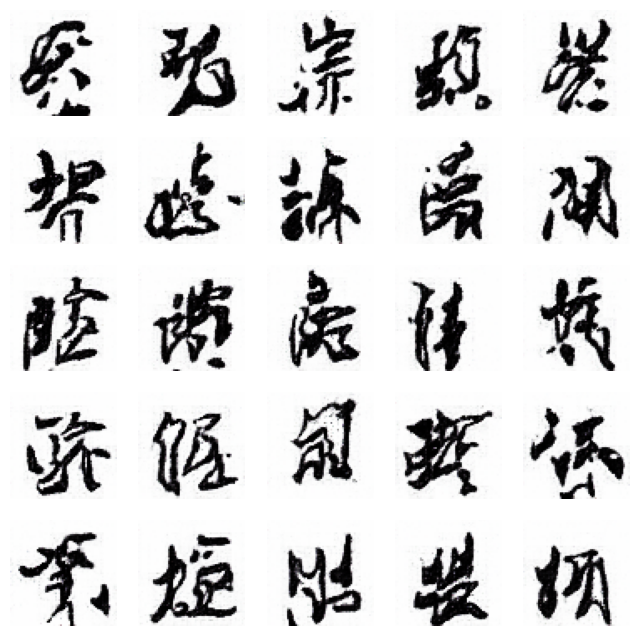

170/170 [==============================] - 385s 2s/step - d_loss: 0.5232 - g_loss: 1.4277
Epoch 62/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5077 - g_loss: 1.4695

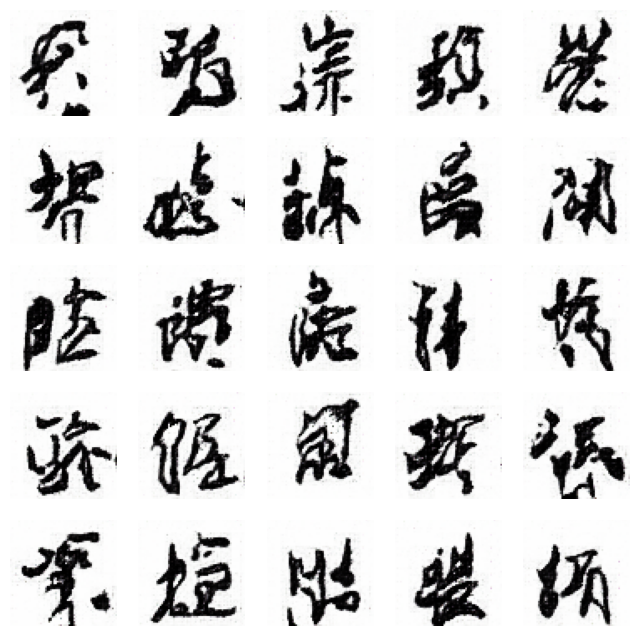

170/170 [==============================] - 385s 2s/step - d_loss: 0.5077 - g_loss: 1.4695
Epoch 63/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5214 - g_loss: 1.4812

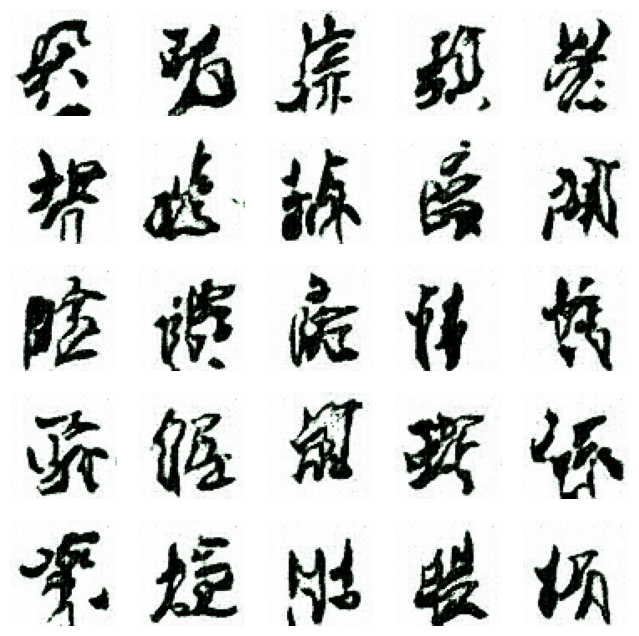

170/170 [==============================] - 386s 2s/step - d_loss: 0.5214 - g_loss: 1.4812
Epoch 64/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5274 - g_loss: 1.5417

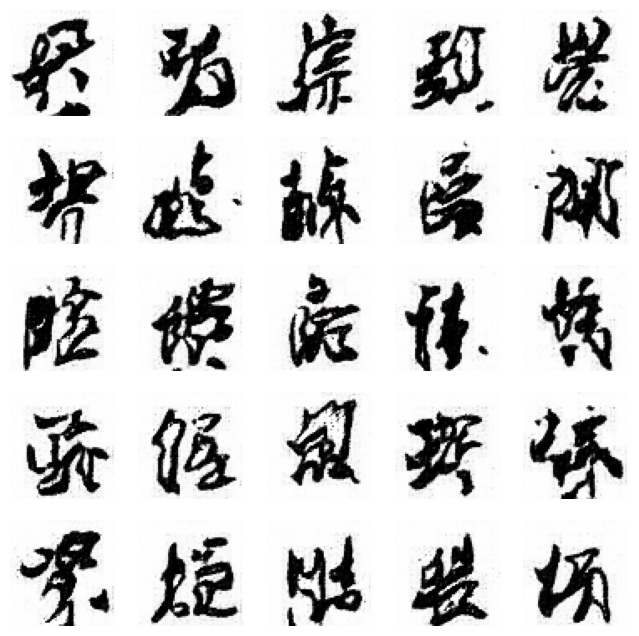

170/170 [==============================] - 385s 2s/step - d_loss: 0.5274 - g_loss: 1.5417
Epoch 65/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5172 - g_loss: 1.4459

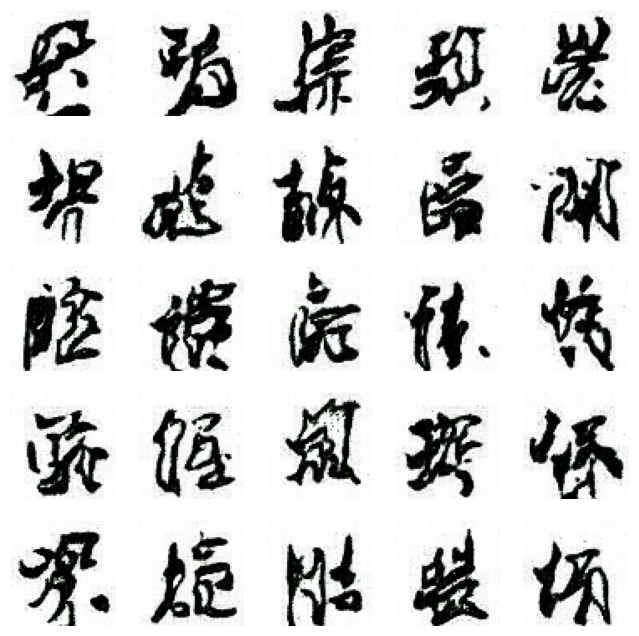

170/170 [==============================] - 386s 2s/step - d_loss: 0.5172 - g_loss: 1.4459
Epoch 66/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5049 - g_loss: 1.5005

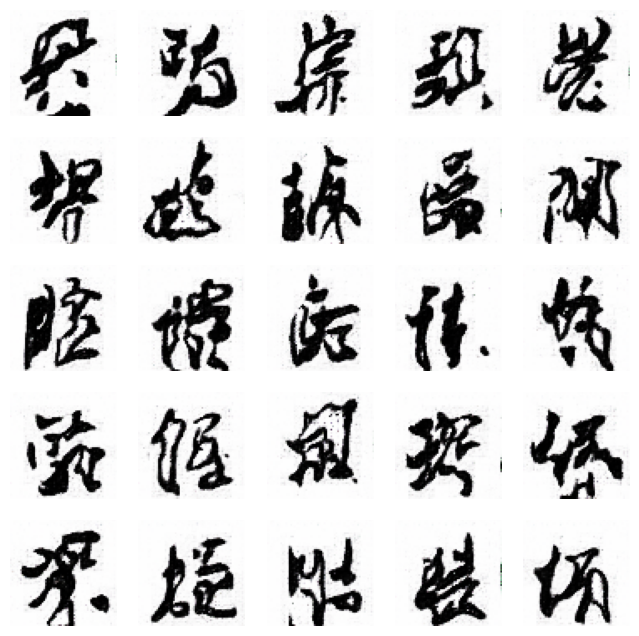

170/170 [==============================] - 387s 2s/step - d_loss: 0.5049 - g_loss: 1.5005
Epoch 67/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5282 - g_loss: 1.4383

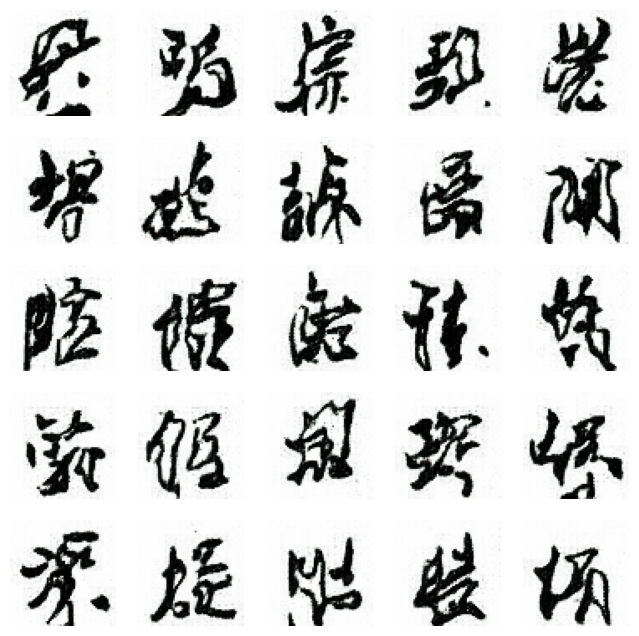

170/170 [==============================] - 397s 2s/step - d_loss: 0.5282 - g_loss: 1.4383
Epoch 68/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5172 - g_loss: 1.4639

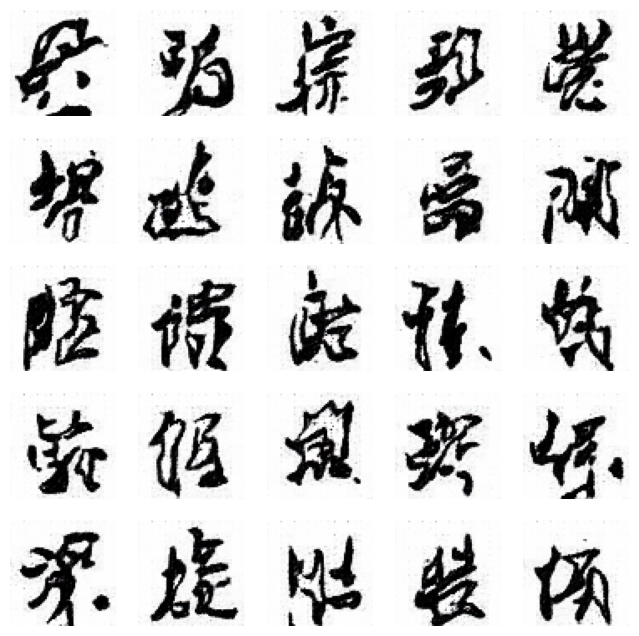

170/170 [==============================] - 389s 2s/step - d_loss: 0.5172 - g_loss: 1.4639
Epoch 69/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5168 - g_loss: 1.4377

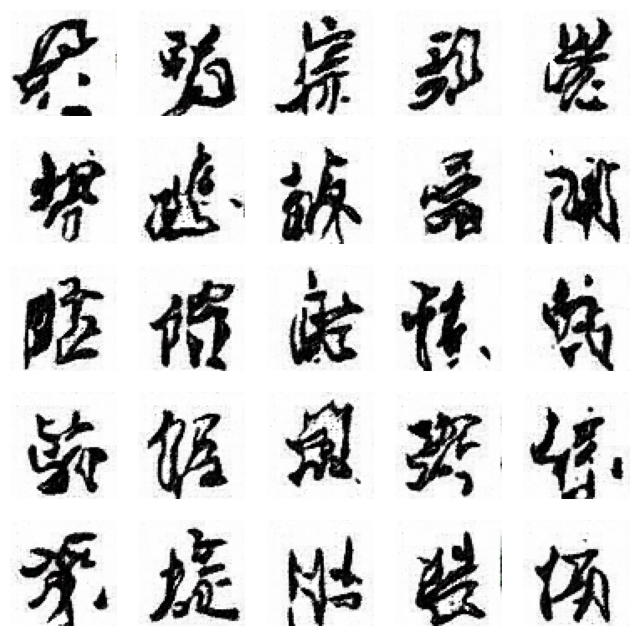

170/170 [==============================] - 387s 2s/step - d_loss: 0.5168 - g_loss: 1.4377
Epoch 70/70
170/170 [==============================] - ETA: 0s - d_loss: 0.5071 - g_loss: 1.4373

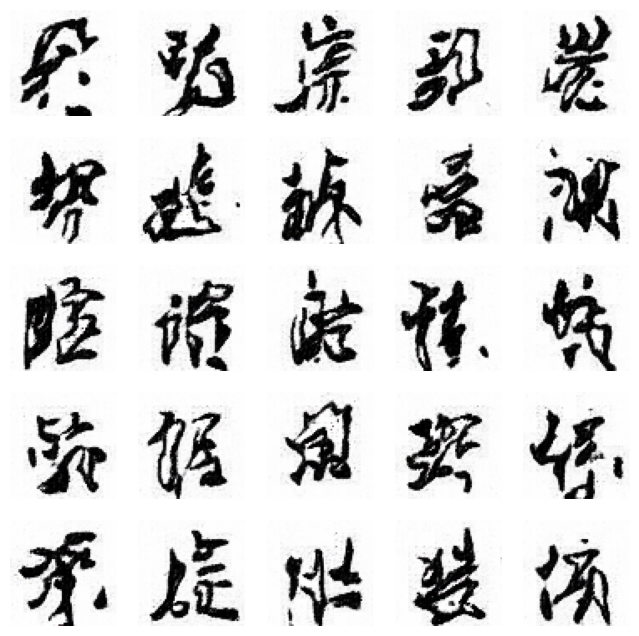

170/170 [==============================] - 385s 2s/step - d_loss: 0.5071 - g_loss: 1.4373


In [ ]:
N_EPOCHS = 70
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate New Anime Image

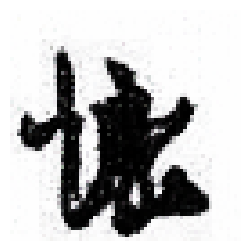

In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()